<a href="https://colab.research.google.com/github/b-aser/CV-IP/blob/main/Intensity_Tranformation_in_Python.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Intensity Transformation on Images using Python

![bit_plane_slicing.png](attachment:bit_plane_slicing.png)

In [56]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Topics Covered -

- Image Negatives
- Log Transformations
- Power Law Transformations
- Piecewise Linear Transformation Functions
- Bit Plane Slicing

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams["figure.autolayout"] = True


### - Image Negatives

In [8]:
img = cv2.imread('/content/drive/MyDrive/CV & IP/images/Fig0304(a)(breast_digital_Xray).tif')

In [9]:
def negative(r):
    s = 255 - r
    return s

Text(0, 0.5, 'Output Intensity Levels')

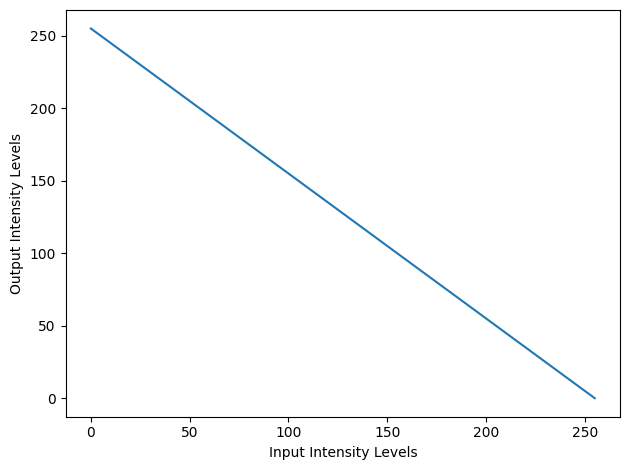

In [10]:
x_values = np.linspace(0,255,500)
y_values = negative(x_values)

plt.plot(x_values, y_values)
plt.xlabel('Input Intensity Levels')
plt.ylabel('Output Intensity Levels')

In [11]:
img_neg = negative(img)

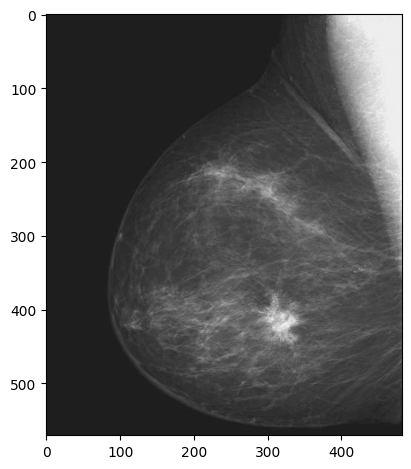

In [12]:
plt.imshow(img)

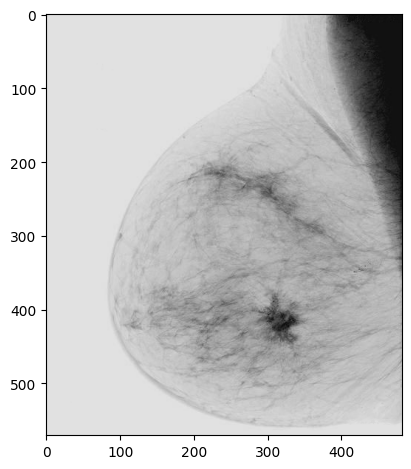

In [13]:
plt.imshow(img_neg)

In [14]:
def scale_image(input_img):
    input_img = input_img / np.max(input_img)
    input_img = (input_img*255).astype('int')
    return input_img


def plot_results(input_img, output_img, x_values, y_values, save_as):

    # plotting the graph
    plt.figure(figsize = (36,12))

    plt.subplot(131)
    plt.imshow(input_img)
    plt.title('Input Image')
    plt.axis('off')

    plt.subplot(132)
    plt.plot(x_values, y_values)
    plt.xlabel('Input Pixels')
    plt.ylabel('Output Pixels')
    plt.grid(True)

    plt.subplot(133)
    plt.imshow(output_img)
    plt.title('Transformed Image')
    plt.axis('off')

    plt.savefig(save_as + '.png')

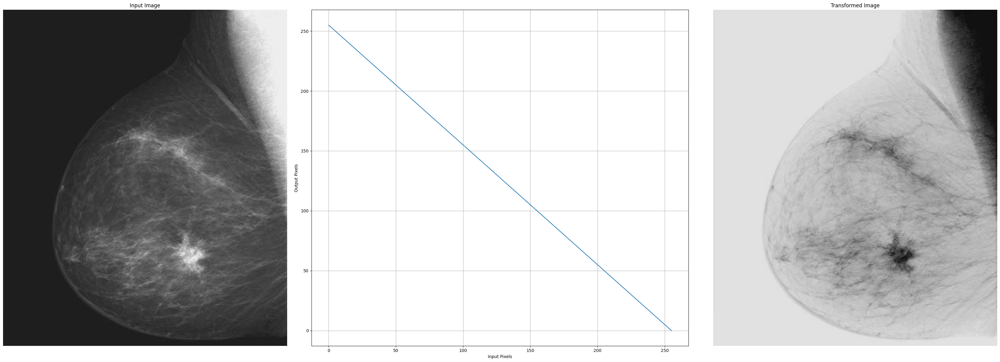

In [15]:
plot_results(img, img_neg, x_values, y_values, 'negative')

### - Log Transformation

In [16]:
im = cv2.imread('/content/drive/MyDrive/CV & IP/images/Fig0305(a)(DFT_no_log).tif')

In [17]:
def logTransform(r, c=1):
    s = c*np.log(1.0+r)
    return s

In [18]:
img_log = logTransform(im)
img_log_scaled = scale_image(img_log)

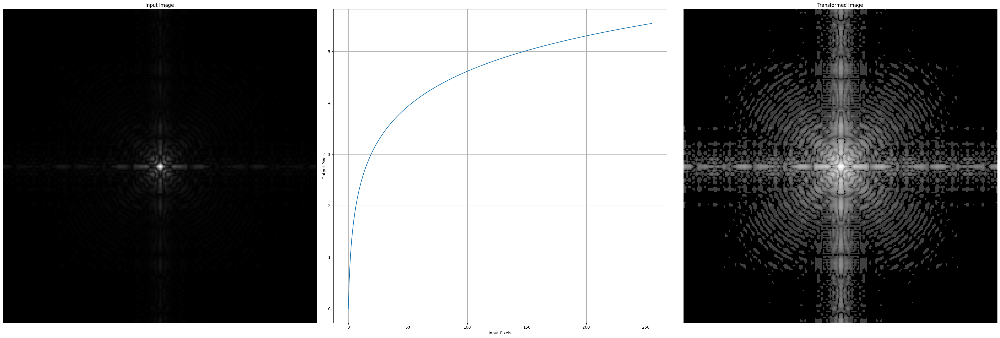

In [19]:
# required for plotting
x_values = np.linspace(0,255,500)
y_values = logTransform(x_values)

plot_results(im, img_log_scaled, x_values, y_values, 'log')

### - Power Law (Gamma) Transformations

In [20]:
spine_img = cv2.imread('/content/drive/MyDrive/CV & IP/images/Fig0308(a)(fractured_spine).tif')

(-0.5, 745.5, 975.5, -0.5)

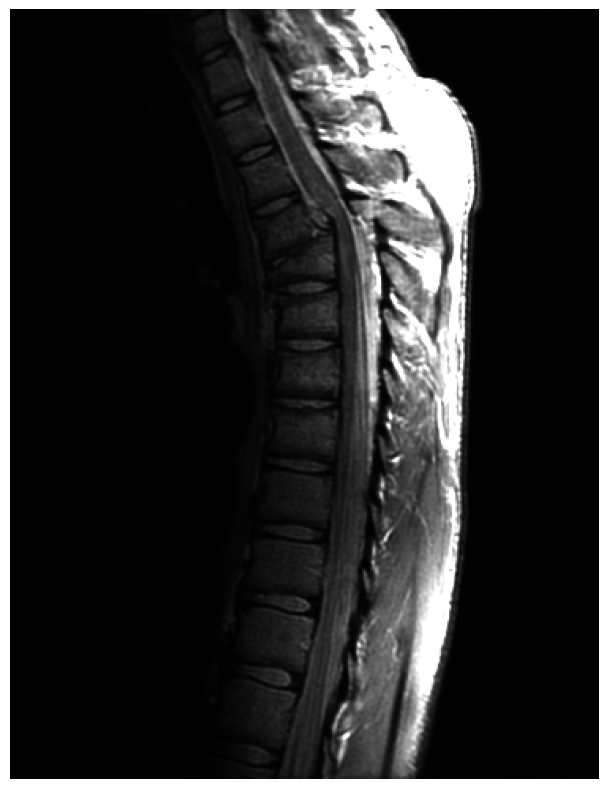

In [21]:
plt.figure(figsize = (12,8))
plt.imshow(spine_img)
plt.axis('off')

In [22]:
def gammaTransform(r, gamma, c=1):
    s = c* (r**gamma)
    return s

### Trying with gamma < 1

In [23]:
img_gamma = gammaTransform(spine_img, 0.4)
img_gamma_scaled = scale_image(img_gamma)

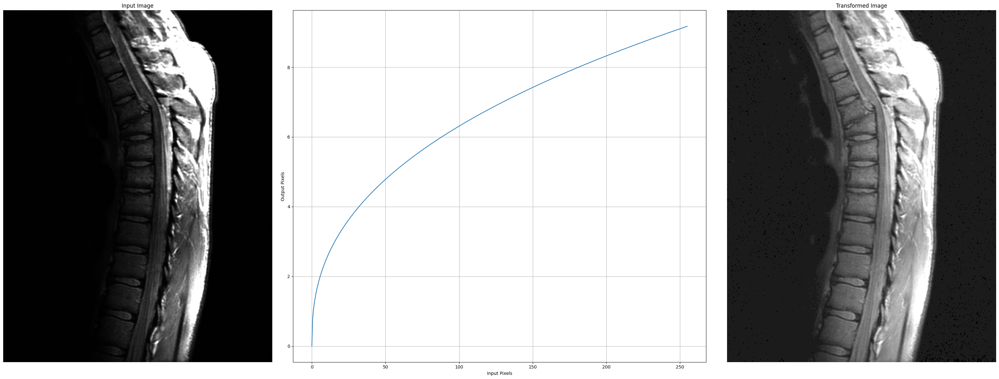

In [24]:
# required for plotting
x_values = np.linspace(0,255,500)
y_values = gammaTransform(x_values, 0.4)

plot_results(spine_img, img_gamma_scaled, x_values, y_values, 'gamma_0_4')

In [25]:
# defing a func to do gamma transform
def performGammaTransform(input_img, gammaValue):
        img_gamma = gammaTransform(input_img, gammaValue)
        img_gamma_scaled = scale_image(img_gamma)

        # required for plotting
        x_values = np.linspace(0,255,500)
        y_values = gammaTransform(x_values, gammaValue)

        plot_results(input_img,img_gamma_scaled, x_values, y_values,"gamma" + str(gammaValue))

        return img_gamma_scaled

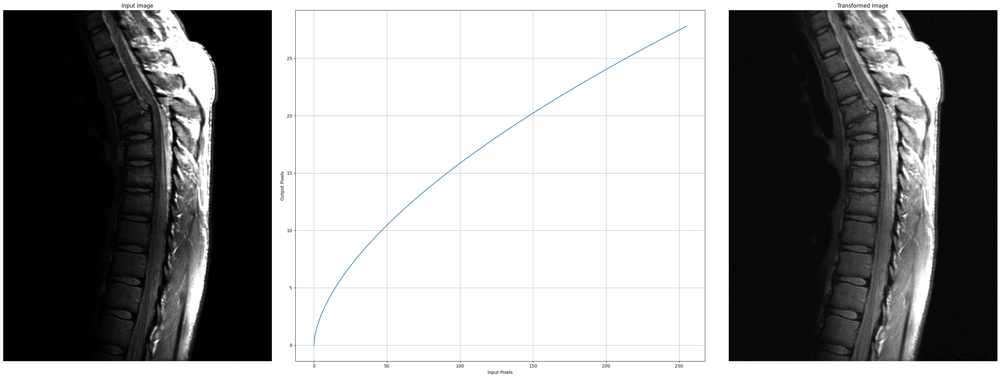

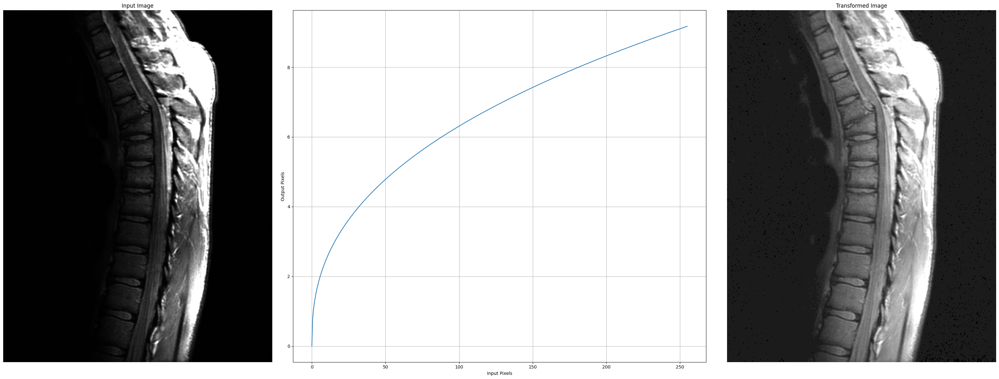

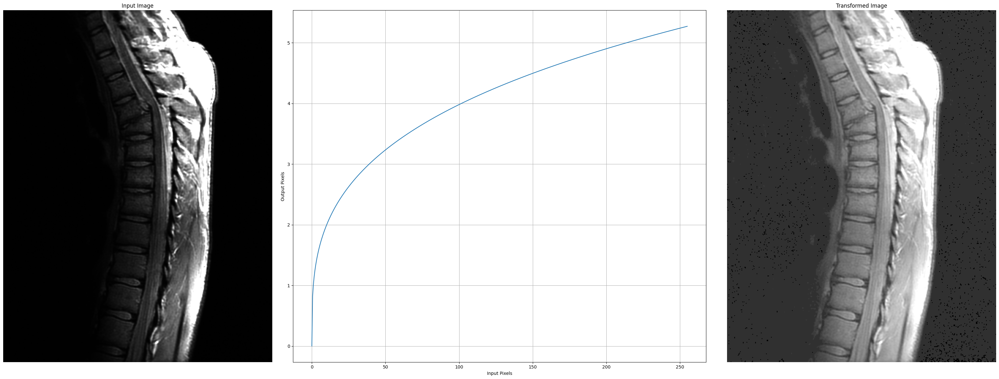

In [26]:
final_images = []

for gammaValue in [0.6, 0.4, 0.3]:
    final_images.append(performGammaTransform(spine_img, gammaValue))

### Comparing the outputs

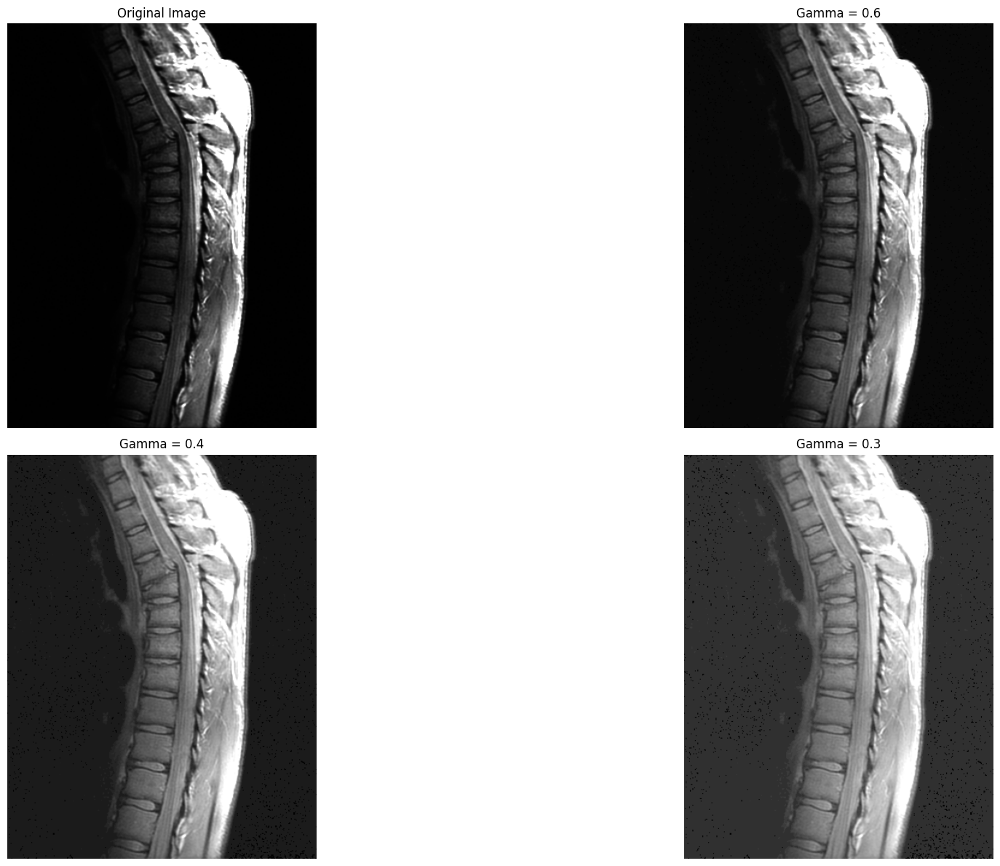

In [27]:
plt.figure(figsize = (24,12))

plt.subplot(221)
plt.imshow(spine_img)
plt.title('Original Image')
plt.axis('off')

plt.subplot(222)
plt.imshow(final_images[0])
plt.title('Gamma = 0.6')
plt.axis('off')

plt.subplot(223)
plt.imshow(final_images[1])
plt.title("Gamma = 0.4")
plt.axis('off')

plt.subplot(224)
plt.imshow(final_images[2])
plt.title("Gamma = 0.3")
plt.axis('off')

plt.tight_layout()
plt.savefig('gamma.png')

### with gamma > 1

In [28]:
arial_im = cv2.imread('/content/drive/MyDrive/CV & IP/images/Fig0309(a)(washed_out_aerial_image).tif')

(-0.5, 764.5, 768.5, -0.5)

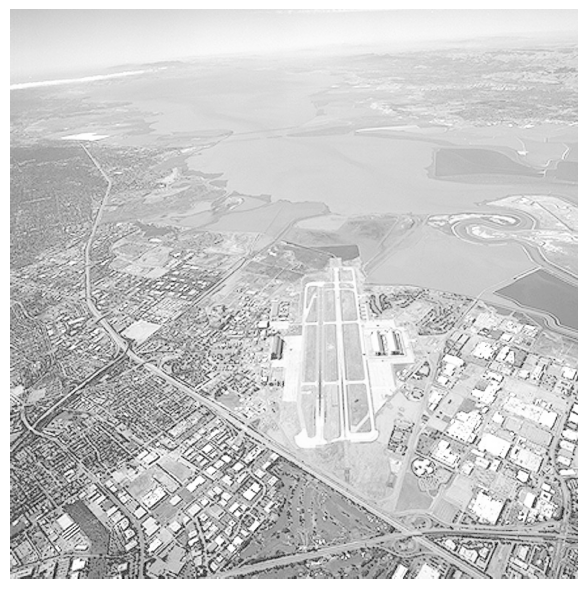

In [29]:
plt.figure(figsize = (10,6))
plt.imshow(arial_im)
plt.axis('off')

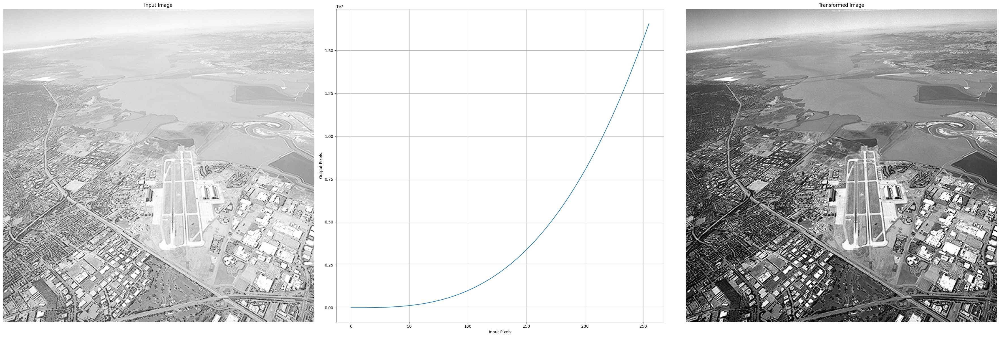

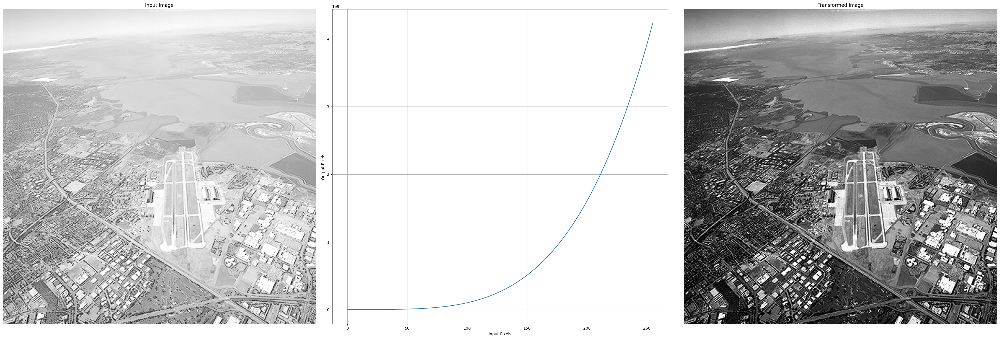

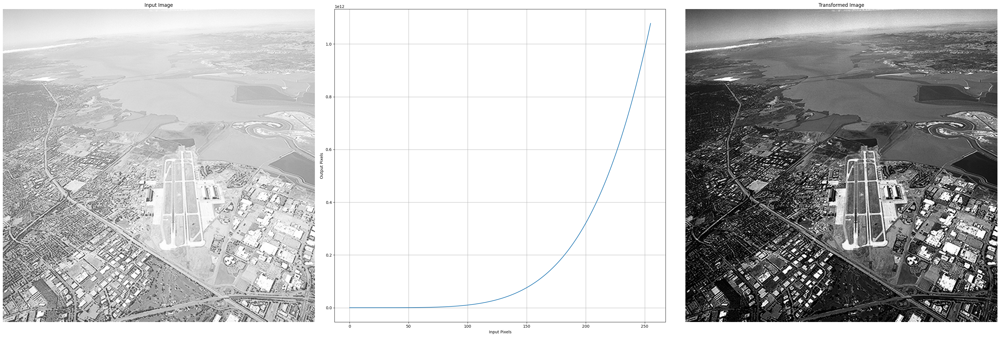

In [30]:
final_images_arial = []

for gammaValue in [3.0, 4.0, 5.0]:
    final_images_arial.append(performGammaTransform(arial_im, gammaValue))

### Comparing the outputs

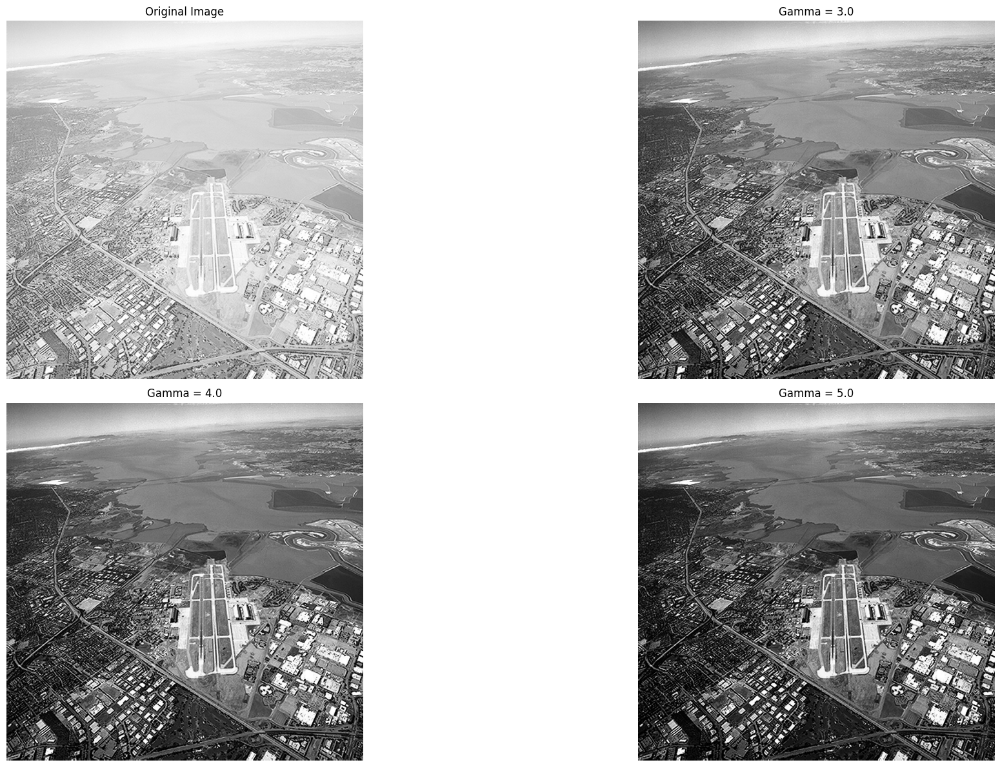

In [31]:
plt.figure(figsize = (24,12))

plt.subplot(221)
plt.imshow(arial_im)
plt.title('Original Image')
plt.axis('off')

plt.subplot(222)
plt.imshow(final_images_arial[0])
plt.title('Gamma = 3.0')
plt.axis('off')

plt.subplot(223)
plt.imshow(final_images_arial[1])
plt.title("Gamma = 4.0")
plt.axis('off')

plt.subplot(224)
plt.imshow(final_images_arial[2])
plt.title("Gamma = 5.0")
plt.axis('off')

plt.tight_layout()
plt.savefig('gamma_arial.png')

## - Contrast Stretching (piecewise linear transformatoin)

In [32]:
im = cv2.imread('/content/drive/MyDrive/CV & IP/images/Fig0310(b)(washed_out_pollen_image).tif')

(-0.5, 888.5, 888.5, -0.5)

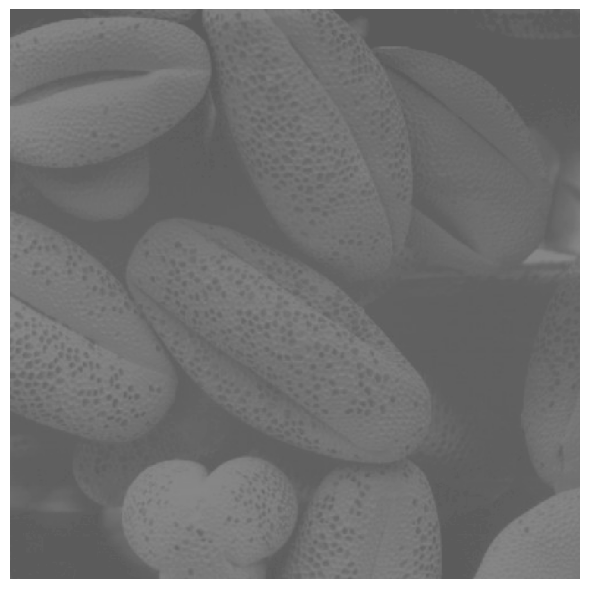

In [33]:
plt.figure(figsize = (10,6))
plt.imshow(im)
plt.axis('off')

In [34]:
def piecewiseLinear(r, r1, s1, r2, s2):
    if r < r1:
        s = (s1 / r1) * r
    elif r > r1 and r < r2:
        s = ((s2 - s1) / (r2 - r1)) * (r - r1) + s1
    else:
        s = ((255 -s2) / (255 - r2)) * (r - r2) + s2

    return int(s)

In [35]:
piecewiseLinearVec = np.vectorize(piecewiseLinear)

In [36]:
x_values = np.linspace(0,255,500)
y_values = piecewiseLinearVec(x_values, 80, 30, 150, 190)

In [37]:
transformed_im = piecewiseLinearVec(im, 80, 30, 150, 190)

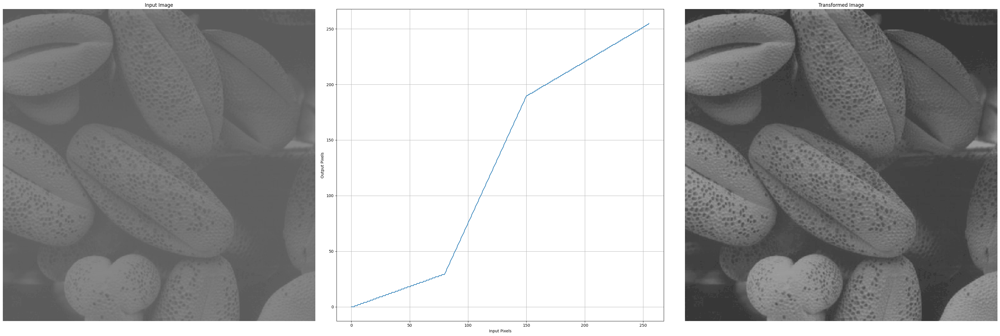

In [38]:
plot_results(im, transformed_im, x_values, y_values, 'piecewise1')

- Using different values for (r1, s1) , (r2, s2)

In [39]:
m = np.mean(im)

transformed_im2 = piecewiseLinearVec(im, m, 0, m, 255)

In [40]:
x_values = np.linspace(0,255,500)
y_values = piecewiseLinearVec(x_values, m, 0, m, 255)

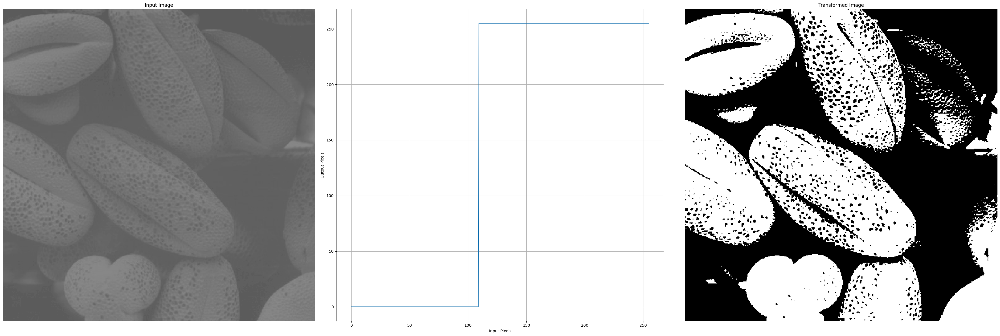

In [41]:
plot_results(im, transformed_im2, x_values, y_values, 'piecewise2')

## - Intensity Level Slicing

In [42]:
kidney_img = cv2.imread('/content/drive/MyDrive/CV & IP/images/Fig0312(a)(kidney).tif')

(-0.5, 719.5, 827.5, -0.5)

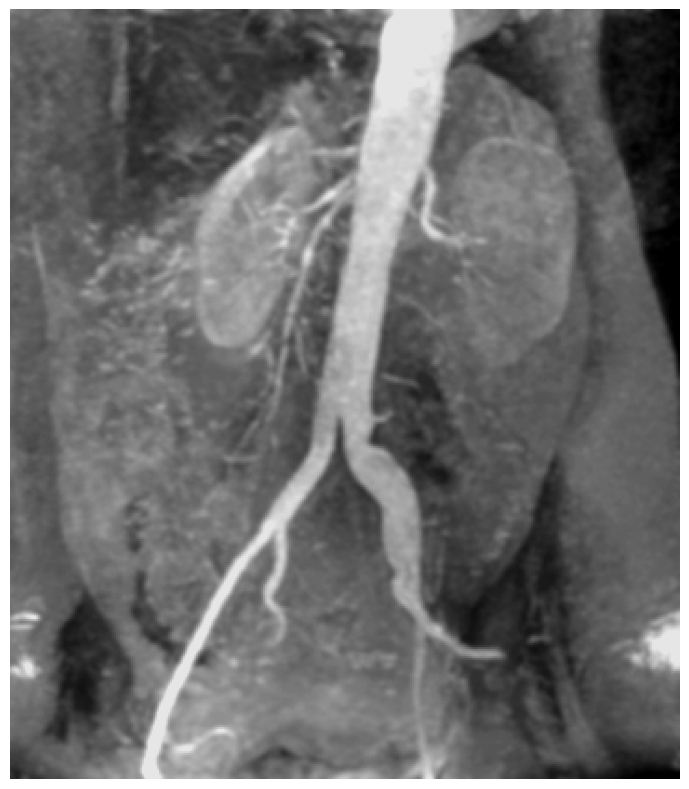

In [43]:
plt.figure(figsize = (12,8))
plt.imshow(kidney_img)
plt.axis('off')

In [44]:
def intensityLevelTransform1(r):
    if r > 140 and r < 210:
        return 255
    else:
        return 0

In [45]:
intensityLevelTransform1vec = np.vectorize(intensityLevelTransform1)

In [46]:
transform1 = intensityLevelTransform1vec(kidney_img)

In [47]:
x_values = np.linspace(0,255,500)
y_values = intensityLevelTransform1vec(x_values)

In [48]:
plot_results(kidney_img, transform1, x_values, y_values, 'intensity_level1')

In [49]:
def intensityLevelTransform2(r):
    if r > 140 and r < 210:
        return 240
    else:
        return r

In [50]:
intensityLevelTransform2vec = np.vectorize(intensityLevelTransform2)

In [51]:
transform2 = intensityLevelTransform2vec(kidney_img)

In [52]:
x_values = np.linspace(0,255,500)
y_values = intensityLevelTransform2vec(x_values)

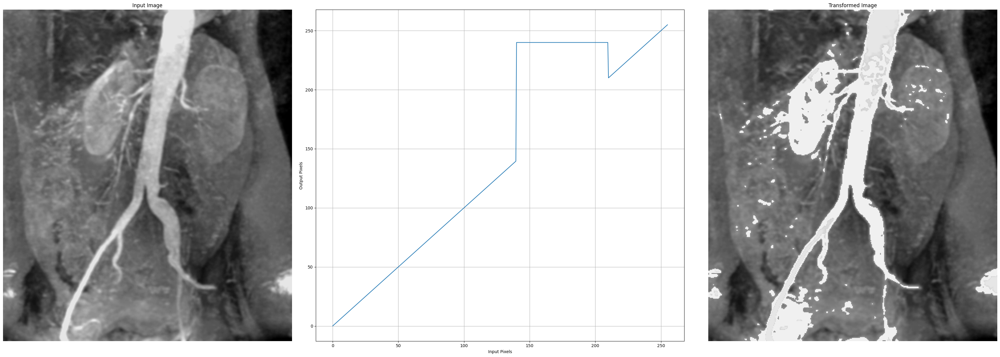

In [53]:
plot_results(kidney_img, transform2, x_values, y_values, 'intensity_level2')

## - Bit Plane Slicing

In [57]:
dollar_img = cv2.imread('/content/drive/MyDrive/CV & IP/images/Fig0314(a)(100-dollars).tif',0)


(-0.5, 1191.5, 499.5, -0.5)

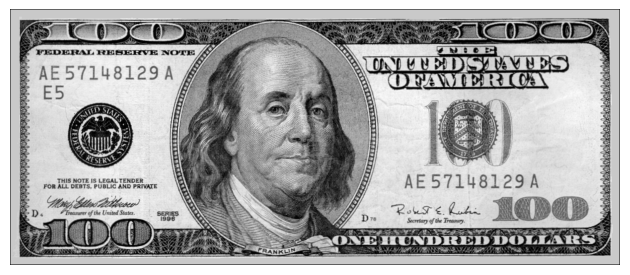

In [58]:
plt.imshow(dollar_img, cmap="gray")
plt.axis('off')

In [59]:
def bitPlaneSlicing(r, bit_plane):
    dec = np.binary_repr(r, width = 8)
    return int(dec[8-bit_plane])

In [60]:
bitPlaneSlicingVec = np.vectorize(bitPlaneSlicing)

In [61]:
eight_bitplace = bitPlaneSlicingVec(dollar_img, bit_plane = 8)

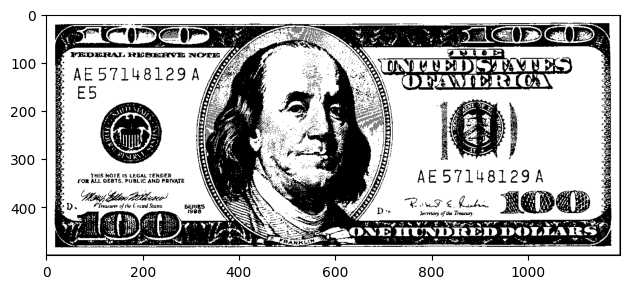

In [62]:
plt.imshow(eight_bitplace, cmap="gray")

In [63]:
bit_planes_dict = {}
for bit_plane in np.arange(8,0, -1):
    bit_planes_dict['bit_plane_' + str(bit_plane)] = bitPlaneSlicingVec(dollar_img, bit_plane = bit_plane)

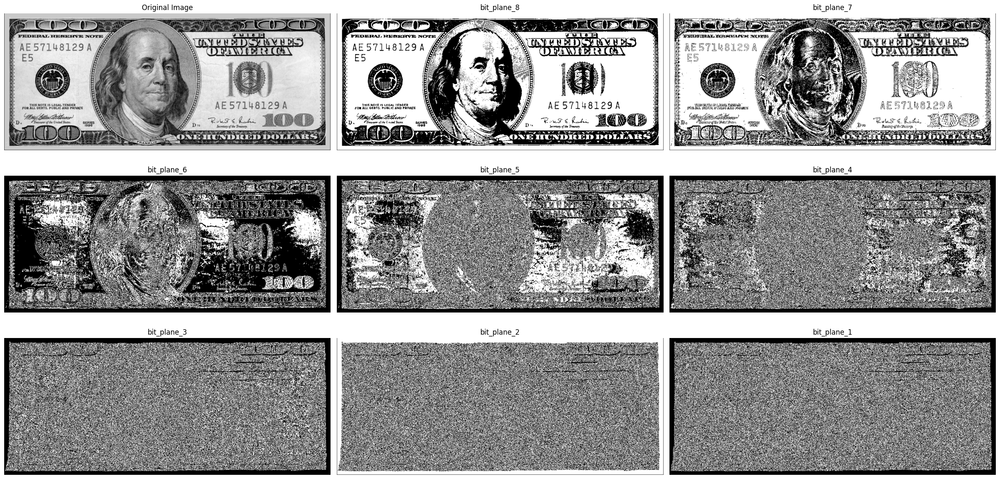

In [64]:
plt.figure(figsize = (24,12))

plt.subplot(331)
plt.imshow(dollar_img, cmap="gray")
plt.title('Original Image')
plt.axis('off')

plt.subplot(332)
plt.imshow(bit_planes_dict['bit_plane_8'], cmap="gray")
plt.title('bit_plane_8')
plt.axis('off')

plt.subplot(333)
plt.imshow(bit_planes_dict['bit_plane_7'], cmap="gray")
plt.title('bit_plane_7')
plt.axis('off')

plt.subplot(334)
plt.imshow(bit_planes_dict['bit_plane_6'], cmap="gray")
plt.title('bit_plane_6')
plt.axis('off')

plt.subplot(335)
plt.imshow(bit_planes_dict['bit_plane_5'], cmap="gray")
plt.title('bit_plane_5')
plt.axis('off')

plt.subplot(336)
plt.imshow(bit_planes_dict['bit_plane_4'], cmap="gray")
plt.title('bit_plane_4')
plt.axis('off')

plt.subplot(337)
plt.imshow(bit_planes_dict['bit_plane_3'], cmap="gray")
plt.title('bit_plane_3')
plt.axis('off')

plt.subplot(338)
plt.imshow(bit_planes_dict['bit_plane_2'], cmap="gray")
plt.title('bit_plane_2')
plt.axis('off')

plt.subplot(339)
plt.imshow(bit_planes_dict['bit_plane_1'], cmap="gray")
plt.title('bit_plane_1')
plt.axis('off')

plt.tight_layout()
plt.savefig('bit_plane_slicing.png')